# Cartoonify Digital Image Processing Project
Dino Anastasopoulos (Student Number: 1900661)

University of the Witwatersrand

Course: APPM4058A - Digital Image Processing

## Imports

In [14]:
#General
import numpy as np
import os
import math
import random
from IPython.display import display_html,display, Markdown

#Image Processing and Displaying
import cv2
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

#Glitch Filter
import glitch_this

print("Succesfully imported all")

Succesfully imported all


## General save function
This function is used by all the effects in this notebook. It applies the respective filter to each input image and saves the result for each, along with an image containing all the results of the specific filter.

In [15]:
def ApplyEffect(effect):
    
    # Store name of effect
    effect_name = effect.__name__
    
    # Set input and output folder
    input_folder_path = "Images/Input/"
    output_folder_path = "Images/Output_Individual/"
    
    fig = plt.figure(figsize=(21, 30))
    plt.axis("off")
    j = 1

    # Iterate over all images
    for image_path in os.listdir(input_folder_path):

        # create the full input path and read the file
        input_path = os.path.join(input_folder_path, image_path)
        image_name = image_path.split(".")[0]

        output = effect(cv2.imread(input_path))

        fullpath = os.path.join(output_folder_path, effect_name + "_" + image_path)
        cv2.imwrite(fullpath, output) # Save each image with effect

        fig.add_subplot(5, 3, j)
        plt.axis('off')
        plt.title(image_name + " " + effect_name)
        plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
        
        j+=1
        
    # Save figure of all images with effect
    fig.savefig("Images/Output_All/ALL_" + effect_name + ".jpg", bbox_inches='tight',pad_inches = 0.1, dpi=600)    

# Main Effects
Below are the 3 main effects of the project, and they require a fair amount of coding and manually implemented image processing techniques.

## Artistic Effect #1 - Cartoonify

### Setup

In [16]:
#Global Variables
gray_kernel_size = 11
color_kernel_size = 11
numColors = 10

def Quantize_Colors(img, k):
    # Reshape image for clustering
    data = np.float32(img).reshape((-1, 3))
    
    # Define K-means clustering criteria
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 20, 1.0)
    
    # K-means clustering
    ret, label, center = cv2.kmeans(data, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
    center = np.uint8(center)
    quanitized = center[label.flatten()]
    quanitized = quanitized.reshape(img.shape)
    
    return quanitized

### Process Visualization

In [17]:
# Read picture
img = cv2.imread("Images/Input/Portrait.jpg") 

#Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

#Blur gray image
gray_blurred = cv2.medianBlur(gray, gray_kernel_size)

#Extract edges from gray image
edges = cv2.adaptiveThreshold(gray_blurred, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 9, 5)

#Perform Color Quantization to decrease number of colors in image
clustered = Quantize_Colors(img, numColors)

#Blur this reduced-colour image to remove "noise" and finer details
clustered_blurred = cv2.medianBlur(clustered, color_kernel_size)

#Combine edges and blurred reduced-colour images for final cartoon
cartoon = cv2.bitwise_and(clustered_blurred, clustered_blurred, mask=edges)

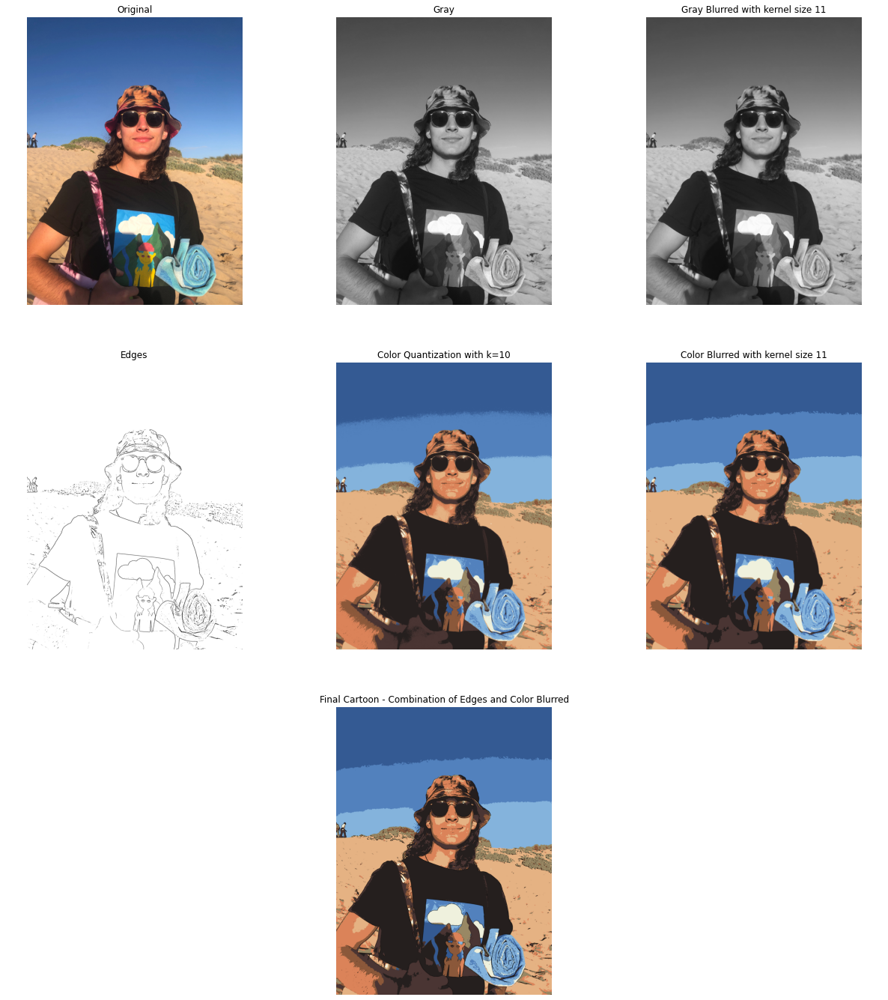

In [18]:
# Display Process
fig = plt.figure(figsize=(21, 24))
plt.axis("off")

fig.add_subplot(3, 3, 1)
plt.title("Original")
plt.axis("off")
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

fig.add_subplot(3, 3, 2)
plt.title("Gray")
plt.axis("off")
plt.imshow(cv2.cvtColor(gray, cv2.COLOR_BGR2RGB))

fig.add_subplot(3, 3, 3)
plt.title("Gray Blurred with kernel size " + str(gray_kernel_size))
plt.axis("off")
plt.imshow(cv2.cvtColor(gray_blurred, cv2.COLOR_BGR2RGB))

fig.add_subplot(3, 3, 4)
plt.title("Edges")
plt.axis("off")
plt.imshow(cv2.cvtColor(edges, cv2.COLOR_BGR2RGB))

fig.add_subplot(3, 3, 5)
plt.title("Color Quantization with k=" + str(numColors))
plt.axis("off")
plt.imshow(cv2.cvtColor(clustered, cv2.COLOR_BGR2RGB))

fig.add_subplot(3, 3, 6)
plt.title("Color Blurred with kernel size " + str(color_kernel_size))
plt.axis("off")
plt.imshow(cv2.cvtColor(clustered_blurred, cv2.COLOR_BGR2RGB))

fig.add_subplot(3, 3, 8)
plt.title("Final Cartoon - Combination of Edges and Color Blurred")
plt.axis("off")
plt.imshow(cv2.cvtColor(cartoon, cv2.COLOR_BGR2RGB))

fig.savefig('Images/Process/Effect1_Cartoonify.jpg',  bbox_inches='tight',pad_inches = 0.1, dpi=600)

### Cartoonify all images

In [19]:
def Cartoonify(img):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    gray_blurred = cv2.medianBlur(gray, gray_kernel_size)
    edges = cv2.adaptiveThreshold(gray_blurredimg, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 9, 5)
    
    clustered = Quantize_Colors(, numColors)
    clustered_blurred = cv2.medianBlur(clustered, color_kernel_size)
    
    cartoon = cv2.bitwise_and(clustered_blurred, clustered_blurred, mask=edges)
    
    return cartoon

## Cartoonify

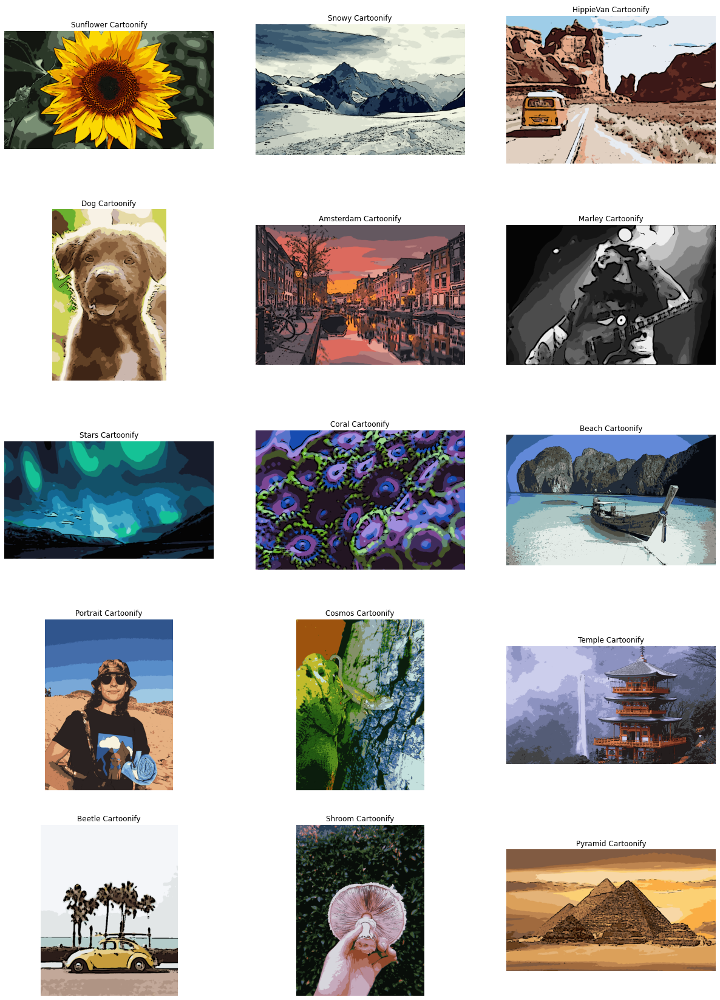

In [20]:
display(Markdown("## Cartoonify"))
ApplyEffect(Cartoonify)

## Artistic Effect #2 - Pencil Sketch

### Setup

In [21]:
kernel_size = 15

### Process Visualization

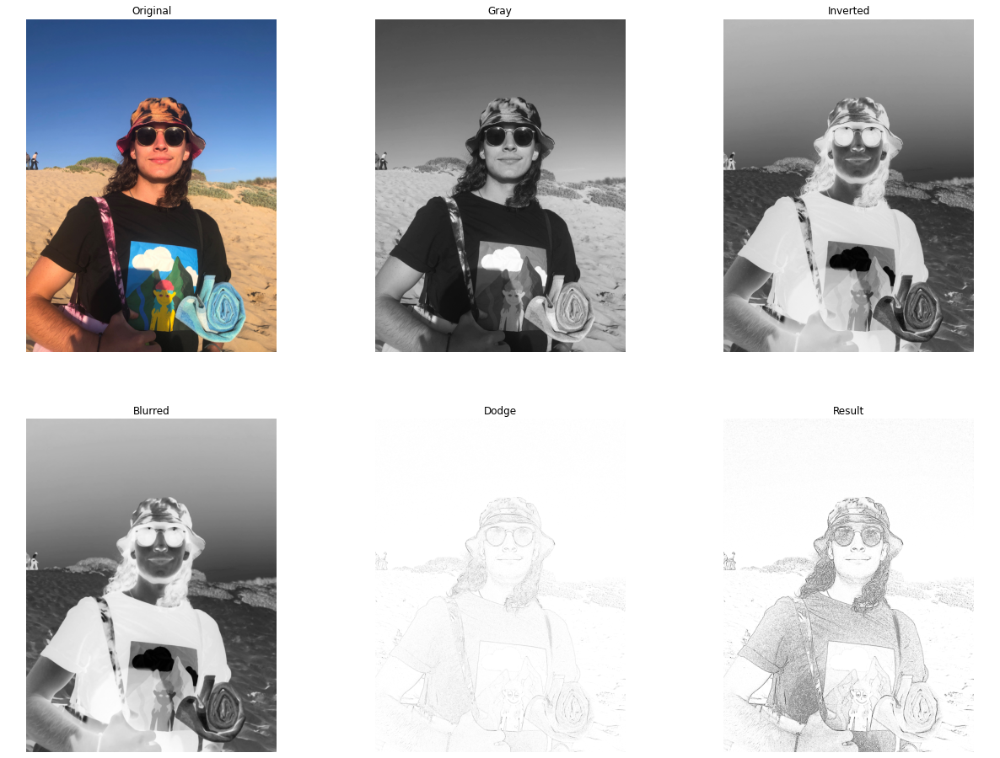

In [41]:
img = cv2.imread("Images/Input/Portrait.jpg") # Read picture

#Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

#Invert original image
inverted = cv2.bitwise_not(gray)

#Blur the inverted image
blurred = cv2.medianBlur(inverted, kernel_size)

#Colour dodge - divide original grayscale image by inverted layer
dodge = cv2.divide(gray, 255-blurred, scale=256)

#Burn
burn = 255 - cv2.divide(255-dodge, 255-blurred, scale=256)
        
# Display process
fig = plt.figure(figsize=(21, 16))
plt.axis("off")

fig.add_subplot(2, 3, 1)
plt.title("Original")
plt.axis("off")
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

fig.add_subplot(2, 3, 2)
plt.title("Gray")
plt.axis("off")
plt.imshow(gray, cmap=plt.cm.gray)

fig.add_subplot(2, 3, 3)
plt.title("Inverted")
plt.axis("off")
plt.imshow(inverted, cmap=plt.cm.gray)

fig.add_subplot(2, 3, 4)
plt.title("Blurred")
plt.axis("off")
plt.imshow(blurred, cmap=plt.cm.gray)

fig.add_subplot(2, 3, 5)
plt.title("Dodge")
plt.axis("off")
plt.imshow(dodge, cmap=plt.cm.gray)

fig.add_subplot(2, 3, 6)
plt.title("Result")
plt.axis("off")
plt.imshow(burn, cmap=plt.cm.gray)

# plt.show(block=True)
fig.savefig('Images/Process/Effect2_Pencil_Sketch.jpg',  bbox_inches='tight',pad_inches = 0.1, dpi=600)

### Pencil sketch all images

In [23]:
def Pencil_Sketch(img):
    
    #Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    #Invert original image
    inverted = cv2.bitwise_not(gray)
    
    #Blur the inverted image
    blurred = cv2.medianBlur(inverted, kernel_size)

    #Colour dodge - divide original grayscale image by inverted layer
    dodge = cv2.divide(gray, 255-blurred, scale=256)
    
    #Burn
    burn = 255 - cv2.divide(255-dodge, 255-blurred, scale=256)
        
    res = burn
        
    return res

## Pencil Sketch

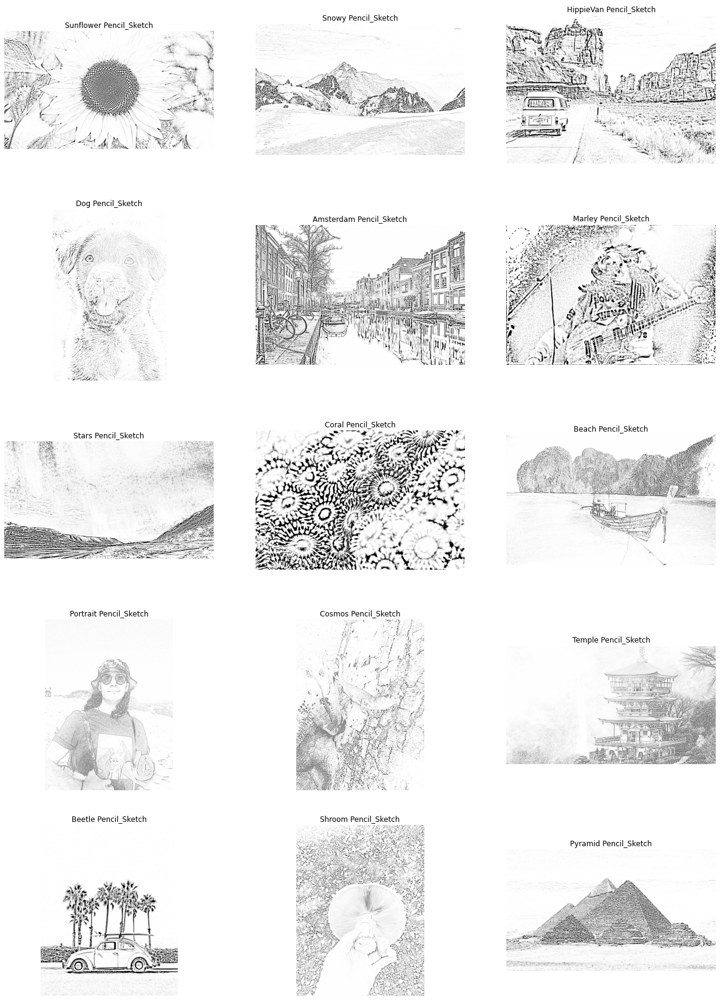

In [24]:
display(Markdown("## Pencil Sketch"))
ApplyEffect(Pencil_Sketch)

## Artistic Effect #3 - Pixelate

### Setup

In [25]:
numPixels = 20
numCols = 30

### Process Visualization

In [48]:
img = cv2.imread("Images/Input/Portrait.jpg") # Read picture

# Get input size
height, width = img.shape[:2]
aspect_ratio = width/height

#Calculate dimensions that will look good
if(width > height):
    pixH = numPixels
    pixW = int(pixH * aspect_ratio)
else:
    pixW = numPixels
    pixH = int(pixW * 1/aspect_ratio)
    

# Desired "pixelated" size
w, h = (pixW, pixH)

# Linear input to "pixelated" size
linear_inter = cv2.resize(img, (w, h), interpolation=cv2.INTER_LINEAR)

# Nearest-neighbour Interpolation
nearest_inter = cv2.resize(img, (w, h), interpolation=cv2.INTER_NEAREST)  

# Cubic Interpolation
cubic_inter = cv2.resize(img, (w, h), interpolation=cv2.INTER_CUBIC)  

# Area Interpolation
area_inter = cv2.resize(img, (w, h), interpolation=cv2.INTER_AREA)  

# Cubic Interpolation
lanczo_inter = cv2.resize(img, (w, h), interpolation=cv2.INTER_LANCZOS4)  

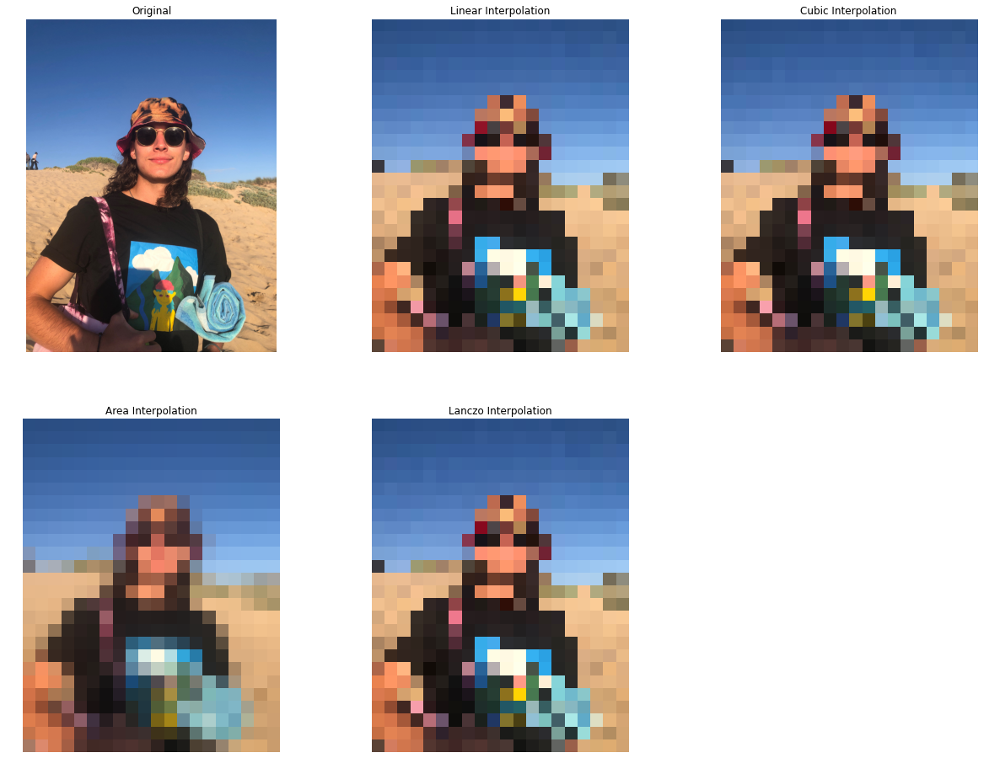

In [49]:
# Display process
fig = plt.figure(figsize=(21, 16))
plt.axis("off")

fig.add_subplot(2, 3, 1)
plt.title("Original")
plt.axis("off")
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

fig.add_subplot(2, 3, 2)
plt.title("Linear Interpolation")
plt.axis("off")
plt.imshow(cv2.cvtColor(linear_inter, cv2.COLOR_BGR2RGB))

fig.add_subplot(2, 3, 3)
plt.title("Cubic Interpolation")
plt.axis("off")
plt.imshow(cv2.cvtColor(cubic_inter, cv2.COLOR_BGR2RGB))


fig.add_subplot(2, 3, 4)
plt.title("Area Interpolation")
plt.axis("off")
plt.imshow(cv2.cvtColor(max_inter, cv2.COLOR_BGR2RGB))


fig.add_subplot(2, 3, 5)
plt.title("Lanczo Interpolation")
plt.axis("off")
plt.imshow(cv2.cvtColor(lanczo_inter, cv2.COLOR_BGR2RGB))


fig.savefig('Images/Process/Effect3_Pixelate.jpg',  bbox_inches='tight',pad_inches = 0.1, dpi=600)

### Pixelate all images

In [50]:
def Pixelate(img):
    # Get input size
    height, width = img.shape[:2]
    aspect_ratio = width/height
    
    if(width > height):
        pixH = numPixels
        pixW = int(pixH * aspect_ratio)
    else:
        pixW = numPixels
        pixH = int(pixW * 1/aspect_ratio)
        
    # Desired "pixelated" size
    w, h = (pixW, pixH)

    # Resize input to "pixelated" size
    pixelated = cv2.resize(img, (w, h), interpolation=cv2.INTER_LINEAR)

    return pixelated

## Pixelate

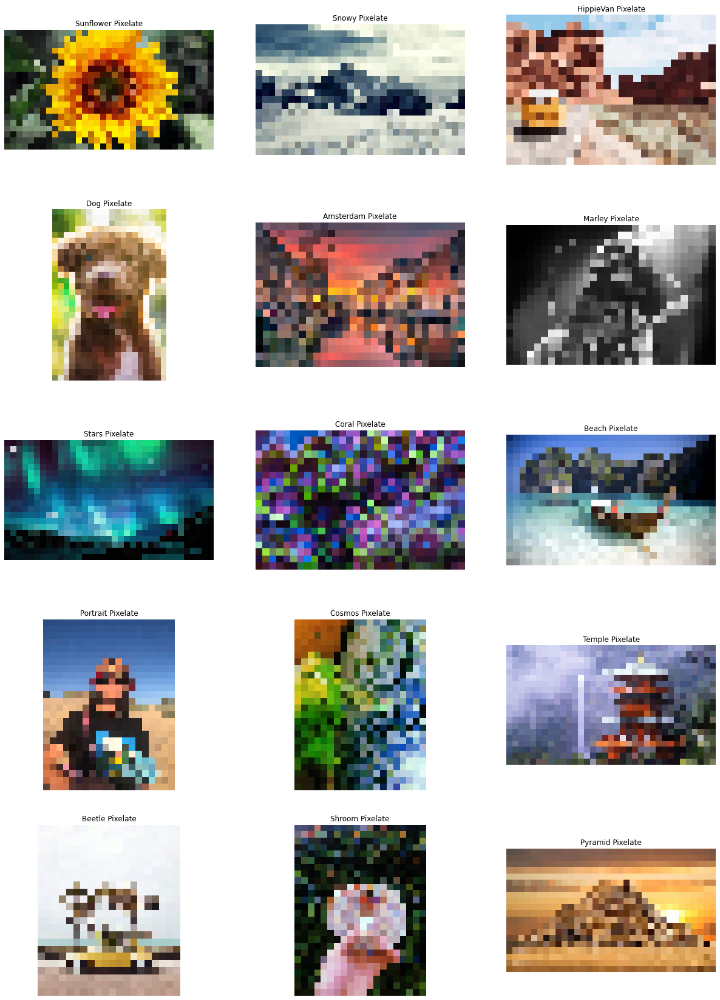

In [51]:
display(Markdown("## Pixelate"))
ApplyEffect(Pixelate)

## Artsitic Effect #4 - Emboss

### Setup

In [29]:
offset = [64, 128]

kernels = [np.array([[-2,-1,0],[-1,1,1],[-1,1,2]]),
    np.array([[-1, 0], [0, 1]]),
    np.array([[1,0],[0,-1]]),
    np.array([[0,1],[-1,0]]),
    np.array([[0,-1],[1,0]]),
    np.array([[1,0,0],[0,0,0],[0,0,-1]]),
    np.array([[-1,0,0],[0,0,0],[0,0,1]])]

### Process Visualization

In [30]:
img = cv2.imread("Images/Input/Portrait.jpg") # Read picture

# #Choose kernel randomly for variation
# kernel = random.choice(kernels)

# #Choose gray value randomly for variation
# gray_value = random.choice(offset)

#Covolve image with kernel
embossed1 = cv2.filter2D(img, -1, kernels[0], delta = 64)
embossed2 = cv2.filter2D(img, -1, kernels[1], delta = 64)
embossed3 = cv2.filter2D(img, -1, kernels[2], delta = 64)
embossed4 = cv2.filter2D(img, -1, kernels[3], delta = 64)
embossed5 = cv2.filter2D(img, -1, kernels[4], delta = 64)
embossed6 = cv2.filter2D(img, -1, kernels[5], delta = 64)
embossed7 = cv2.filter2D(img, -1, kernels[6], delta = 64)

6

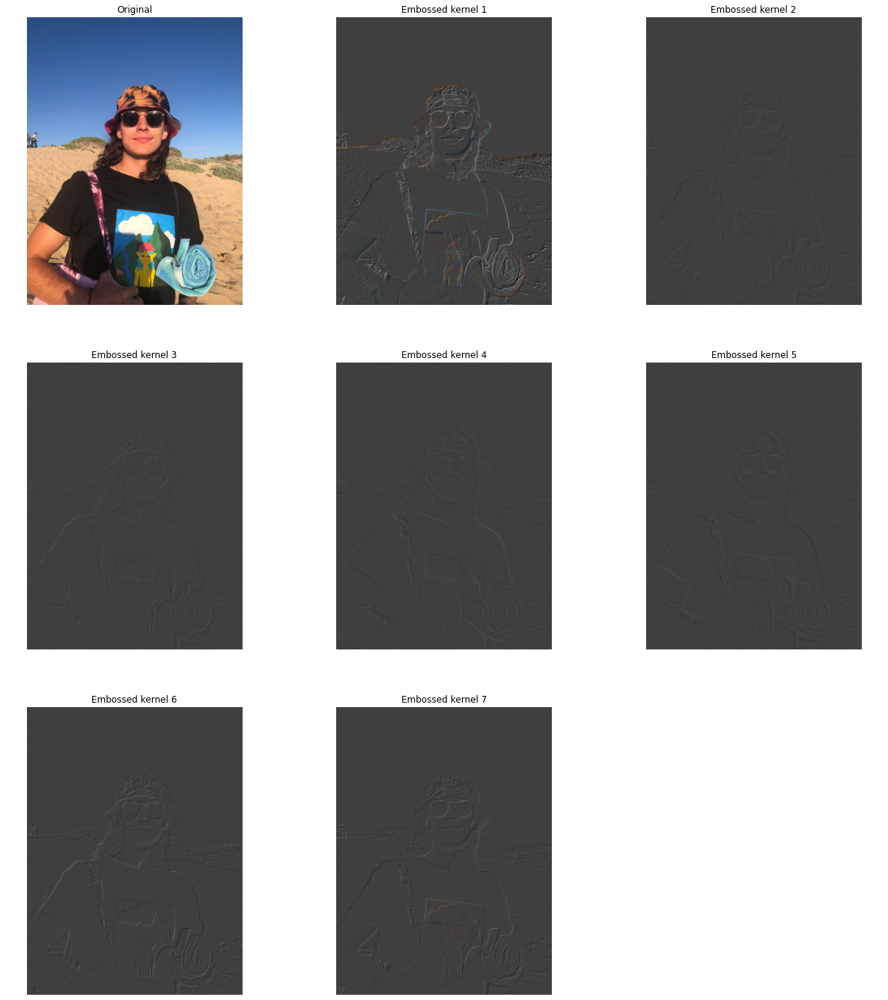

In [31]:
# Display Process
fig = plt.figure(figsize=(21, 24))
plt.axis("off")

fig.add_subplot(3, 3, 1)
plt.title("Original")
plt.axis("off")
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

fig.add_subplot(3, 3, 2)
plt.title("Embossed kernel 1")
plt.axis("off")
plt.imshow(cv2.cvtColor(embossed1, cv2.COLOR_BGR2RGB))

fig.add_subplot(3, 3, 3)
plt.title("Embossed kernel 2")
plt.axis("off")
plt.imshow(cv2.cvtColor(embossed2, cv2.COLOR_BGR2RGB))

fig.add_subplot(3, 3, 4)
plt.title("Embossed kernel 3")
plt.axis("off")
plt.imshow(cv2.cvtColor(embossed3, cv2.COLOR_BGR2RGB))

fig.add_subplot(3, 3, 5)
plt.title("Embossed kernel 4")
plt.axis("off")
plt.imshow(cv2.cvtColor(embossed4, cv2.COLOR_BGR2RGB))

fig.add_subplot(3, 3, 6)
plt.title("Embossed kernel 5")
plt.axis("off")
plt.imshow(cv2.cvtColor(embossed5, cv2.COLOR_BGR2RGB))

fig.add_subplot(3, 3, 7)
plt.title("Embossed kernel 6")
plt.axis("off")
plt.imshow(cv2.cvtColor(embossed6, cv2.COLOR_BGR2RGB))

fig.add_subplot(3, 3, 8)
plt.title("Embossed kernel 7")
plt.axis("off")
plt.imshow(cv2.cvtColor(embossed7, cv2.COLOR_BGR2RGB))

fig.savefig('Images/Process/Effect4_Emboss.jpg',  bbox_inches='tight',pad_inches = 0.1, dpi=600)

### Emboss all images

In [32]:
def Emboss(img):
    #Choose kernel randomly for variation
    kernel = random.choice(kernels)
    
    #Choose gray value randomly for variation
    gray_value = random.choice(offset)
    
    #Covolve image with kernel
    embossed = cv2.filter2D(img, -1, kernel, delta = gray_value)
    
    return embossed

## Emboss

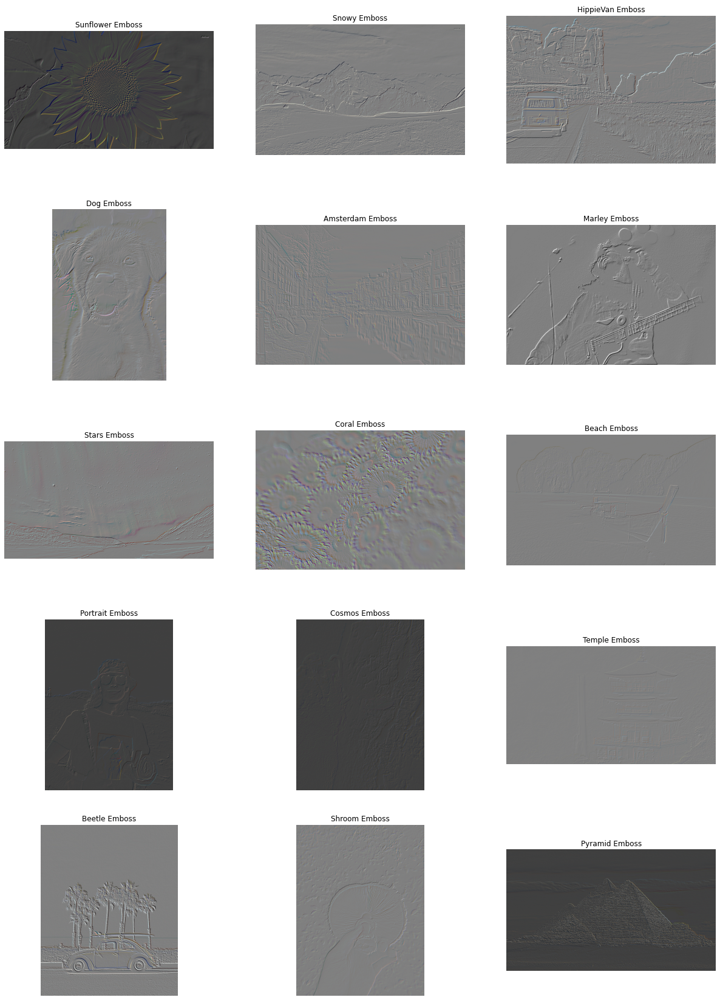

In [33]:
display(Markdown("## Emboss"))
ApplyEffect(Emboss)

# Extra Effects
These effects are mostly built in and require  very little code. I have added them for interest sake, as they are very cool and aesthetically pleasing .

## Extra Effect #1 - ColourMaps

### Duo Chromatic

## Duo Chromatic

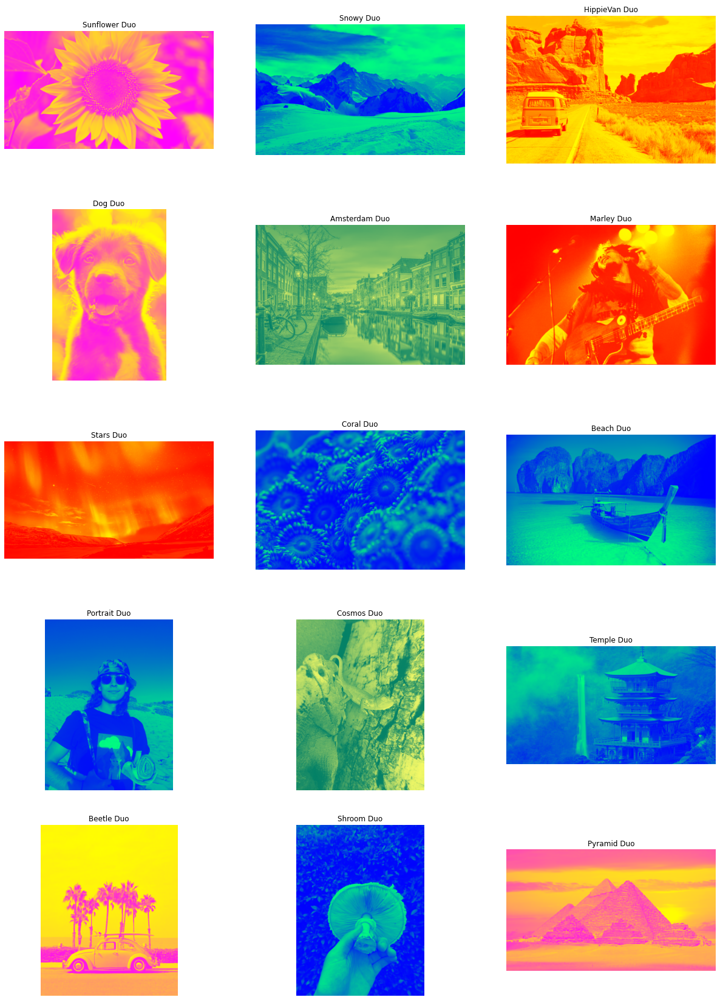

In [34]:
def Duo(img):
    colourMaps = [cv2.COLORMAP_AUTUMN, cv2.COLORMAP_WINTER, cv2.COLORMAP_SUMMER, cv2.COLORMAP_SPRING]
    chosenMap = random.choice(colourMaps)
    res = cv2.applyColorMap(img, chosenMap)
    return res

display(Markdown("## Duo Chromatic"))
ApplyEffect(Duo)

### Thermal 1

## Thermal 1

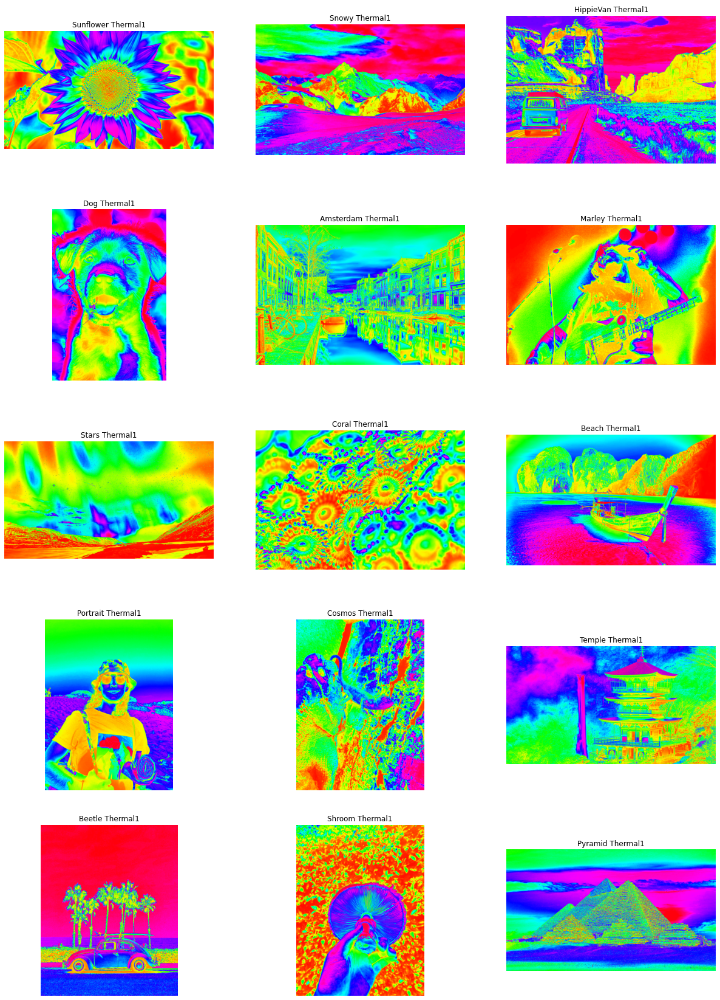

In [35]:
def Thermal1(img):
    res = cv2.applyColorMap(img, cv2.COLORMAP_HSV)
    return res

display(Markdown("## Thermal 1"))
ApplyEffect(Thermal1)

### Thermal 2

## Thermal 2

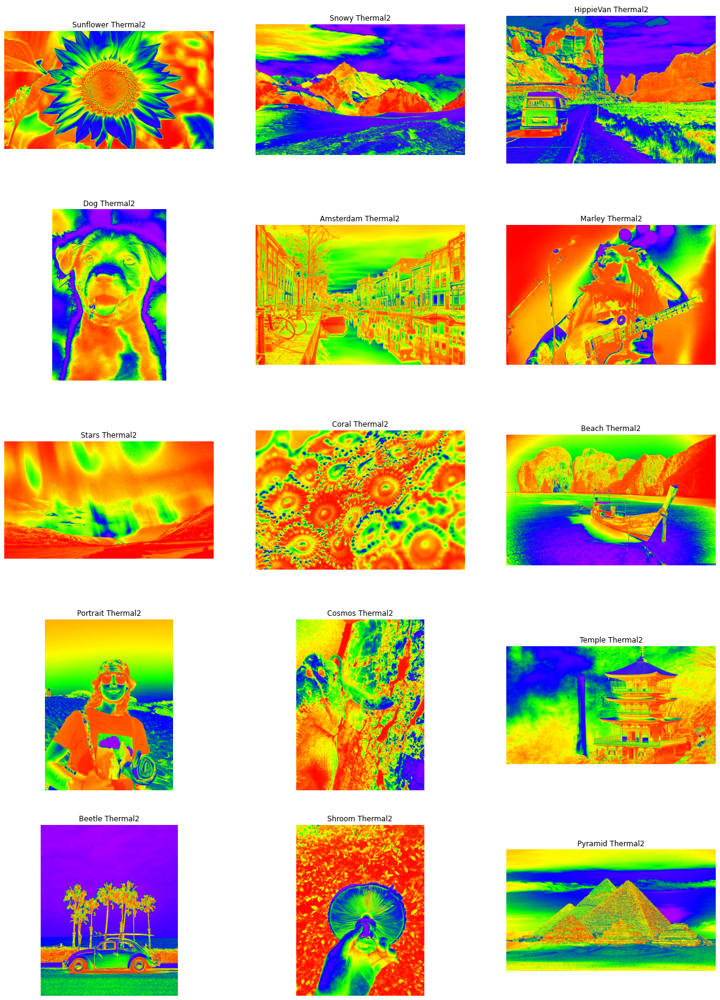

In [36]:
def Thermal2(img):
    res = cv2.applyColorMap(img, cv2.COLORMAP_RAINBOW)
    return res


display(Markdown("## Thermal 2"))
ApplyEffect(Thermal2)

### Thermal 3

## Thermal 3

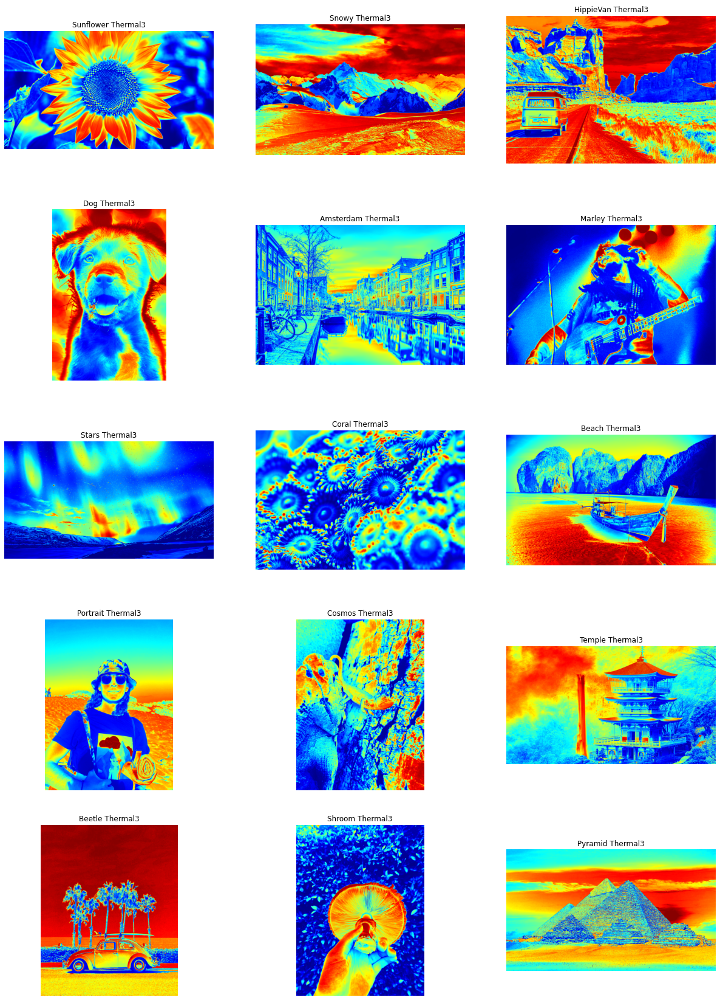

In [6]:
def Thermal3(img):
    res = cv2.applyColorMap(img, cv2.COLORMAP_JET)
    return res

display(Markdown("## Thermal 3"))
ApplyEffect(Thermal3)

### UV

## UV

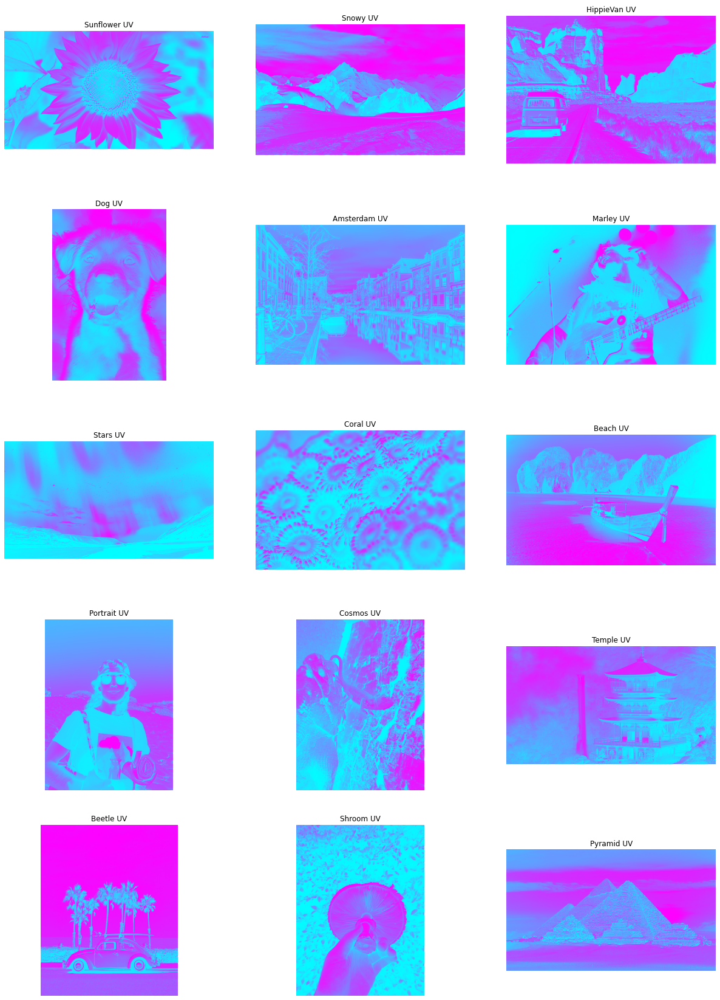

In [7]:
def UV(img):
    res = cv2.applyColorMap(img, cv2.COLORMAP_COOL)
    return res


display(Markdown("## UV"))
ApplyEffect(UV)

## Extra Effect #2 - WaterColour

## WaterColor

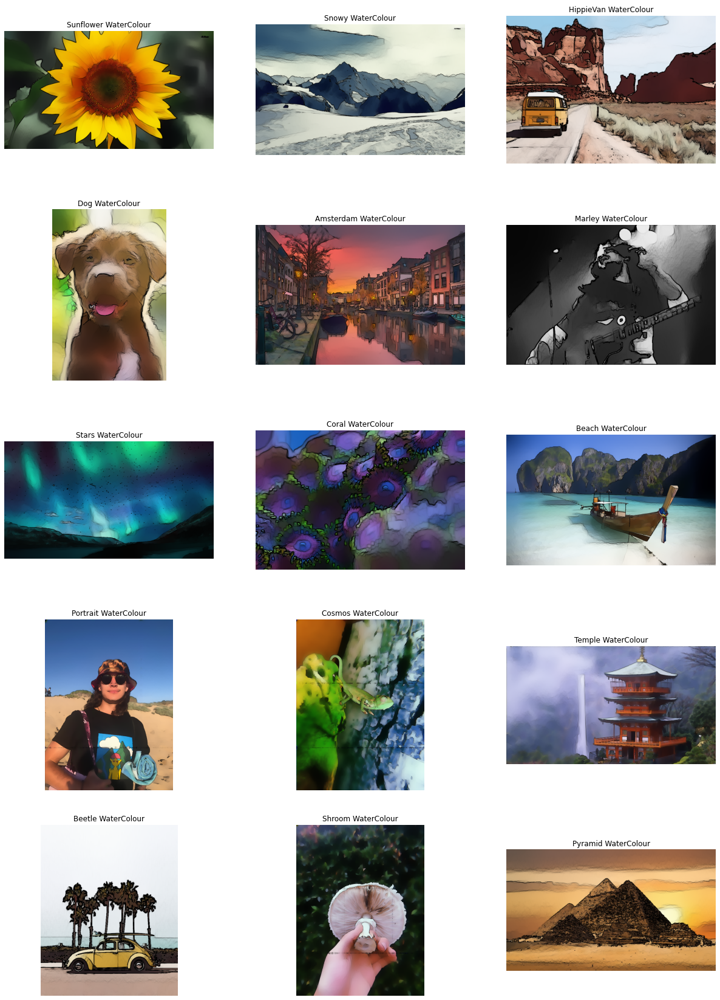

In [8]:
def WaterColour(img):
    res = cv2.stylization(img, sigma_s=100, sigma_r=0.9)
    return res

display(Markdown("## WaterColor"))
ApplyEffect(WaterColour)

## Extra Effect #3 - Enhance

## Enhance

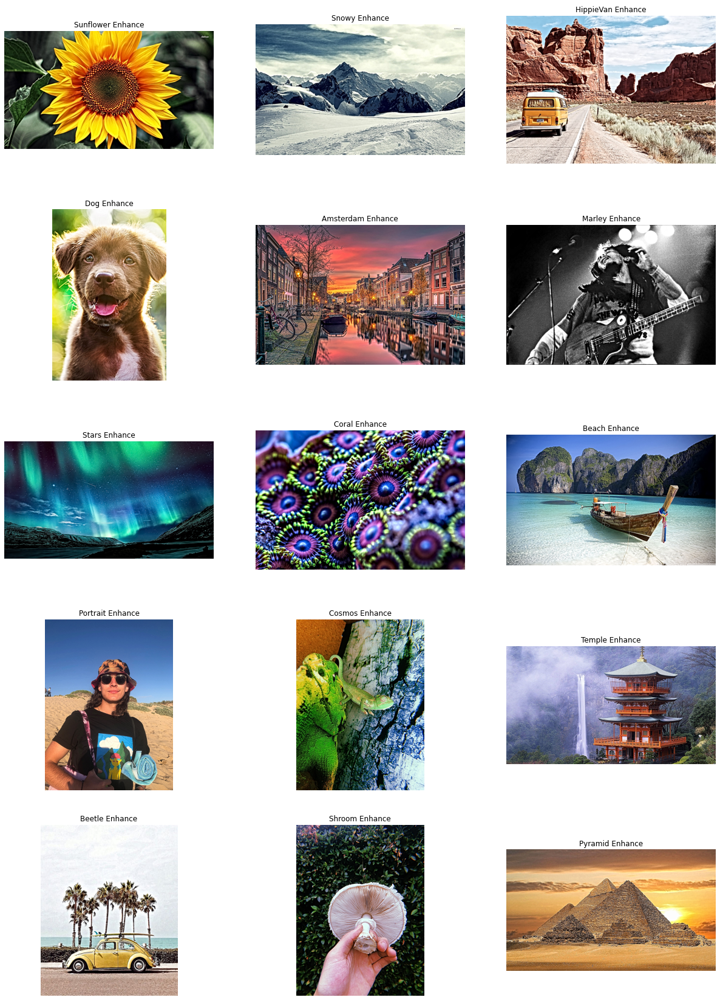

In [9]:
def Enhance(img):
    res = cv2.detailEnhance(img)
    return res

display(Markdown("## Enhance"))
ApplyEffect(Enhance)

## Extra Effect #4 - Glitch
This effect uses a library called glitch-this by https://github.com/TotallyNotChase. It is a command line tool, and so the below function and code is necessary to run through the images and apply the effect by means of a terminal command.

In [12]:
%%capture
def Glitch():
        
    #Set input and output folder
    input_folder_path = "Images/Input/"
    output_folder_path = "Images/Output_Individual/"

    j = 1
    
    fig = plt.figure(figsize=(21, 30))
    plt.axis("off")

    # iterate through the names of contents of the folder
    for image_path in os.listdir(input_folder_path):
        
        glitch_level = random.randint(3,10)

        # create the full input path and read the file
        input_path = os.path.join(input_folder_path, image_path)
        print(input_path)
        image_name = image_path.split(".")[0] 
        
        output_path = output_folder_path + "Glitch_" + image_name  + ".jpg"
        
        #This is to randomly add scan lines
        if glitch_level%2 == 0 :
            !glitch_this -f -c -s $input_path $glitch_level -o $output_path

        else:        
            !glitch_this -f -c $input_path $glitch_level -o $output_path
                 
        img = cv2.imread(output_path)
        fig.add_subplot(5,3,j)
        plt.axis('off')
        plt.title(image_name + " Glitch" )
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))      
        j+=1
        
    plt.savefig("Images/Output_All/ALL_Glitch.jpg", bbox_inches='tight',pad_inches = 0.1,  dpi=600)        
Glitch()

## Glitch

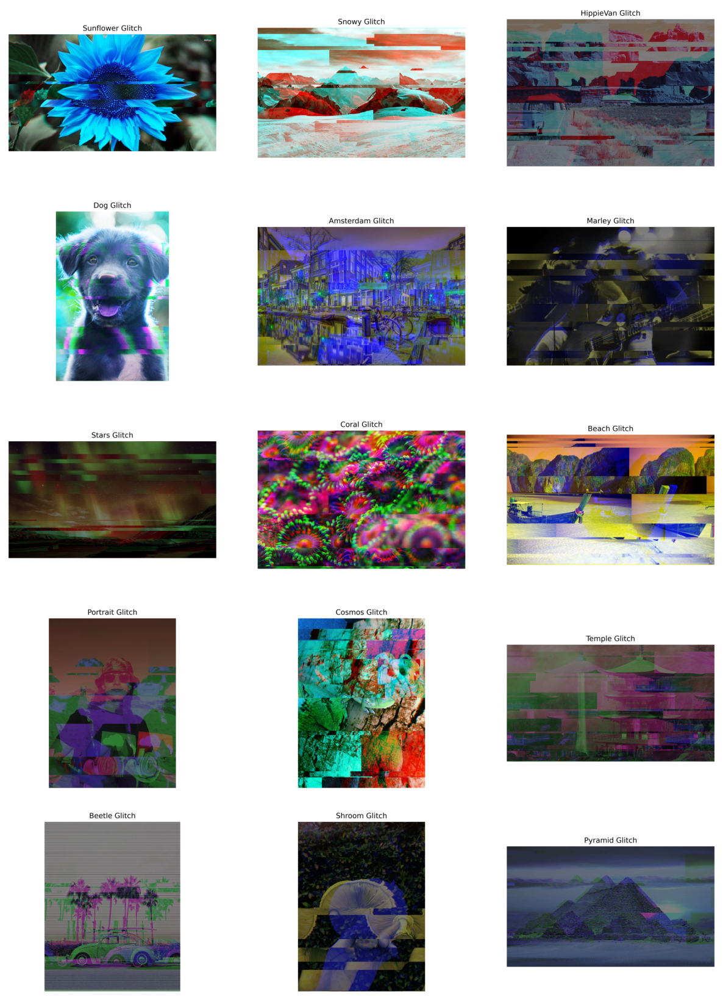

In [13]:
ALL_Glitch = cv2.imread("Images/Output_All/ALL_Glitch.jpg")
plt.figure(figsize=(21,30))
plt.axis("off")
display(Markdown("## Glitch"))
plt.imshow(ALL_Glitch)